# Importing the neccessary libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import librosa
import random
import librosa, IPython
import librosa.display as lplt

ModuleNotFoundError: No module named 'seaborn'

In [12]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Importing the dataset**

In [13]:
data_3_sec = pd.read_csv('/content/drive/MyDrive/PRML/Project/features_3_sec.csv')
data_30_sec = pd.read_csv('/content/drive/MyDrive/PRML/Project/features_30_sec.csv')

In [14]:
data_3_sec.head(10)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues
5,blues.00000.5.wav,66149,0.376670,0.089702,0.132618,0.003583,1994.915219,211700.619569,2152.767854,74263.873102,...,31.448069,-3.448373,34.284130,-0.416165,40.791092,-3.649625,32.457901,3.025218,28.892687,blues
6,blues.00000.6.wav,66149,0.379909,0.088827,0.130335,0.003166,1962.150096,177443.070045,2146.503479,98020.541422,...,33.954071,-2.068194,25.623655,1.428141,47.957699,-3.267124,39.382240,3.276939,25.999132,blues
7,blues.00000.7.wav,66149,0.331880,0.092119,0.140600,0.002546,1701.890924,35678.130616,1979.387612,36670.725886,...,38.456211,-3.637886,24.530296,-0.105148,26.716150,-2.016985,23.150423,0.210787,42.512966,blues
8,blues.00000.8.wav,66149,0.347877,0.094209,0.133130,0.002538,1746.473502,138073.931244,1887.619723,117069.920049,...,44.311455,-4.370029,29.873167,2.114592,33.843155,-2.264663,80.812393,3.758598,97.618835,blues
9,blues.00000.9.wav,66149,0.358061,0.082957,0.115312,0.001846,1763.948942,61493.423121,1874.195710,51944.921435,...,43.967834,-3.448304,48.671944,0.099792,41.839546,-7.677177,96.253654,0.791776,40.416420,blues


In [15]:
data_3_sec.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9990 entries, 0 to 9989
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   filename                 9990 non-null   object 
 1   length                   9990 non-null   int64  
 2   chroma_stft_mean         9990 non-null   float64
 3   chroma_stft_var          9990 non-null   float64
 4   rms_mean                 9990 non-null   float64
 5   rms_var                  9990 non-null   float64
 6   spectral_centroid_mean   9990 non-null   float64
 7   spectral_centroid_var    9990 non-null   float64
 8   spectral_bandwidth_mean  9990 non-null   float64
 9   spectral_bandwidth_var   9990 non-null   float64
 10  rolloff_mean             9990 non-null   float64
 11  rolloff_var              9990 non-null   float64
 12  zero_crossing_rate_mean  9990 non-null   float64
 13  zero_crossing_rate_var   9990 non-null   float64
 14  harmony_mean            

Therefore there are no NAN values present in the dataset.

In [16]:
print(pd.unique(data_3_sec['label']))   # The number of music types

['blues' 'classical' 'country' 'disco' 'hiphop' 'jazz' 'metal' 'pop'
 'reggae' 'rock']


In [17]:
print("Shape of Dataset ->",data_3_sec.shape)
data_3_sec.label.value_counts().reset_index()

Shape of Dataset -> (9990, 60)


,index,label
0,blues,1000
1,jazz,1000
2,metal,1000
3,pop,1000
4,reggae,1000
5,disco,999
6,classical,998
7,hiphop,998
8,rock,998
9,country,997


In [18]:
df=data_3_sec.copy()
data_30_sec.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


In [19]:
base_dir = '/content/drive/MyDrive/PRML/Project/genres_original'
df['full_path'] = base_dir+ '/' + df['label'] + '/' + df['label']+'.000'+str(random.randint(0,9))+str(random.randint(0,9))+'.wav'
blues = df[df['label'] == "blues"].sample(1, random_state = 32)['full_path'].values[0]
jazz = df[df['label'] == 'jazz'].sample(1, random_state = 33)['full_path'].values[0]
metal = df[df['label'] == "metal"].sample(1, random_state = 33)['full_path'].values[0]
pop = df[df['label'] == 'pop'].sample(1, random_state = 33)['full_path'].values[0]
reggae = df[df['label'] == 'reggae'].sample(1, random_state = 33)['full_path'].values[0]
disco = df[df['label'] == 'disco'].sample(1, random_state = 33)['full_path'].values[0]
classical = df[df['label'] == 'classical'].sample(1, random_state = 33)['full_path'].values[0]
hiphop = df[df['label'] == 'hiphop'].sample(1, random_state = 33)['full_path'].values[0]
rock = df[df['label'] == 'rock'].sample(1, random_state = 33)['full_path'].values[0]
country = df[df['label'] == 'country'].sample(1, random_state = 33)['full_path'].values[0]

print(country)

/content/drive/MyDrive/PRML/Project/genres_original/country/country.00015.wav


## *Playing few of our samples*

*Blues is a music genre and musical form which was originated in the Deep South of the United States around the 1860s by African-Americans from roots in African-American work songs and spirituals*

In [20]:
import IPython.display as ipd
ipd.Audio(blues)

*Jazz is a music genre that originated in the African-American communities of New Orleans, Louisiana in the late 19th and early 20th centuries, with its roots in blues and ragtime*

In [21]:
import IPython.display as ipd
ipd.Audio(jazz)

*Heavy metal is a genre of rock music that developed in the late 1960s and early 1970s, largely in the United Kingdom and United States*

In [22]:
import IPython.display as ipd
ipd.Audio(metal)

*Pop is a genre of popular music that originated in its modern form during the mid-1950s in the United States and the United Kingdom.*

In [23]:
import IPython.display as ipd
ipd.Audio(pop)

*Reggae is a music genre that originated in Jamaica in the late 1960s.*

In [24]:
import IPython.display as ipd
ipd.Audio(reggae)

*Disco is a genre of dance music and a subculture that emerged in the 1970s from the United States' urban nightlife scene*

In [25]:
import IPython.display as ipd
ipd.Audio(disco)

*Classical music generally refers to the formal musical tradition of the Western world, considered to be distinct from Western folk music or popular music traditions.*

In [26]:
import IPython.display as ipd
ipd.Audio(classical)

*Hip hop music, also known as rap music, is a style of music which came into existence in the United States during the mid- 1970s,*

In [27]:
import IPython.display as ipd
ipd.Audio(hiphop)

*Rock music is a broad genre of popular music that originated as "rock and roll" in the United States in the late 1940s and early 1950st*

In [28]:
import IPython.display as ipd
ipd.Audio(rock)

*Country music is an American musical style that incorporates elements of folk, bluegrass, blues, and rural dance music.*

In [29]:
import IPython.display as ipd
ipd.Audio(country)

The column filename and length are not useful hence those are dropped.

In [ ]:
data_3_sec.drop(['filename','length'], axis=1, inplace=True)
data_30_sec.drop(['filename','length'], axis=1, inplace=True)

In [ ]:
data_3_sec.describe()

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
count,9990.000000,9990.000000,9990.000000,9.990000e+03,9990.000000,9.990000e+03,9990.000000,9.990000e+03,9990.000000,9.990000e+03,...,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000
mean,0.379534,0.084876,0.130859,2.676388e-03,2199.219431,4.166727e+05,2241.385959,1.182711e+05,4566.076592,1.628790e+06,...,1.448240,49.988755,-4.198706,51.962753,0.739943,52.488851,-2.497306,54.973829,-0.917584,57.322614
std,0.090466,0.009637,0.068545,3.585628e-03,751.860611,4.349644e+05,543.854449,1.013505e+05,1642.065335,1.489398e+06,...,5.735149,34.442816,5.677379,36.400669,5.181313,38.177120,5.111799,41.585677,5.253243,46.444212
min,0.107108,0.015345,0.000953,4.379535e-08,472.741636,8.118813e+02,499.162910,1.183520e+03,658.336276,1.145102e+03,...,-26.850016,1.325786,-27.809795,1.624544,-20.733809,3.437439,-27.448456,3.065302,-35.640659,0.282131
25%,0.315698,0.079833,0.083782,6.145900e-04,1630.680158,1.231961e+05,1887.455790,4.876553e+04,3378.311110,5.595514e+05,...,-2.227478,29.584894,-7.951722,29.863448,-2.516638,29.636197,-5.734123,30.496412,-4.004475,30.011365
50%,0.384741,0.085108,0.121253,1.491318e-03,2208.628236,2.650692e+05,2230.575595,8.996072e+04,4631.377892,1.160080e+06,...,1.461623,41.702393,-4.443021,42.393583,0.733772,41.831377,-2.702366,43.435253,-1.030939,44.332155
75%,0.442443,0.091092,0.176328,3.130862e-03,2712.581884,5.624152e+05,2588.340505,1.585674e+05,5591.634521,2.262437e+06,...,5.149752,59.274619,-0.726945,61.676964,3.888734,62.033906,0.514246,65.328602,2.216603,68.210421
max,0.749481,0.120964,0.442567,3.261522e-02,5432.534406,4.794119e+06,3708.147554,1.235143e+06,9487.446477,1.298320e+07,...,39.144405,683.932556,34.048843,529.363342,36.970322,629.729797,31.365425,1143.230591,34.212101,910.473206


# Visualization

There are so many unique features present. Let us see what these features mean individually.

### **MFCC:Mel-Frequency Cepstral Coefficients**

*    The envelope of the time power spectrum of the speech signal is representative of the vocal tract and MFCC.
*   The range of human hearing is 20Hz to 20kHz. Imagine a tune at 300 Hz. This would sound something like the standard dialer tone of a land-line phone. Now imagine a tune at 400 Hz (a little higher pitched dialer tone). Now compare the distance between these two howsoever this may be perceived by your brain. Now imagine a 900 Hz signal (similar to a microphone feedback sound) and a 1kHz sound. The perceived distance between these two sounds may seem greater than the first two although the actual difference is the same (100Hz). The mel scale tries to capture such differences. A frequency measured in Hertz (f) can be converted to the Mel scale using the following formula :

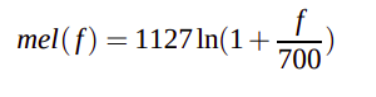

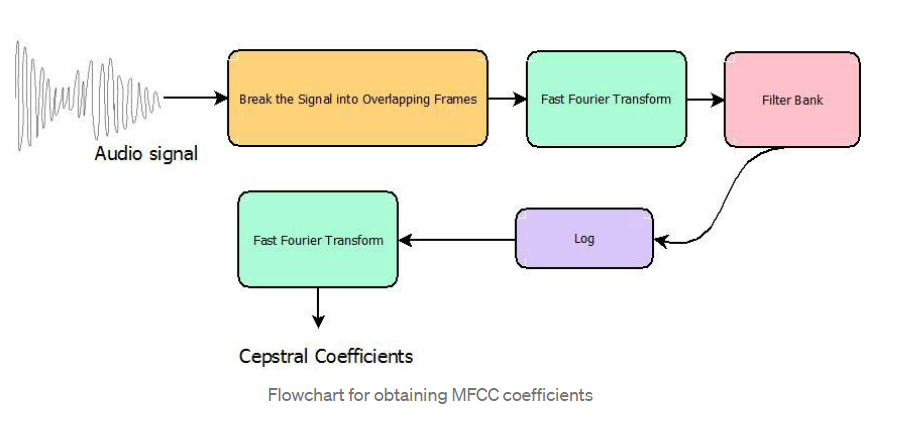

In [ ]:
y, sr = librosa.load('blues.00000.wav')

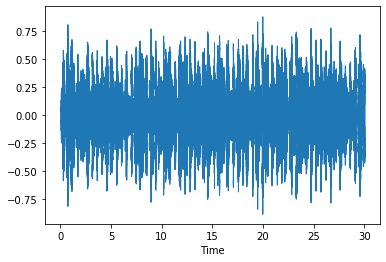

In [ ]:
import librosa.display
librosa.display.waveshow(y, sr=sr)
plt.show()

In [30]:
x_blues, fs1 = librosa.load(blues)
x_jazz, fs2 = librosa.load(jazz)
x_metal, fs3 = librosa.load(metal)
x_pop, fs4 = librosa.load(pop)
x_reggae, fs5 = librosa.load(reggae)
x_disco, fs6 = librosa.load(disco)
x_classical, fs7 = librosa.load(classical)
x_hiphop, fs8 = librosa.load(hiphop)
x_rock, fs9 = librosa.load(rock)
x_country, fs10 = librosa.load(country)

In [35]:
#This function will plot the audio file of the wave file imputed.
def plot_mfcc(wav_file,wave_name):
  x, fs = librosa.load(wav_file)
  mfccs = librosa.feature.mfcc(x, sr=fs)
  fig, ax = plt.subplots(1,figsize = (8, 6))
  img = librosa.display.specshow(mfccs, sr=fs, x_axis='time')
  fig.colorbar(img, ax=ax)
  ax.set(title='MFCC For ' +wave_name+ ' genre')
  return ax



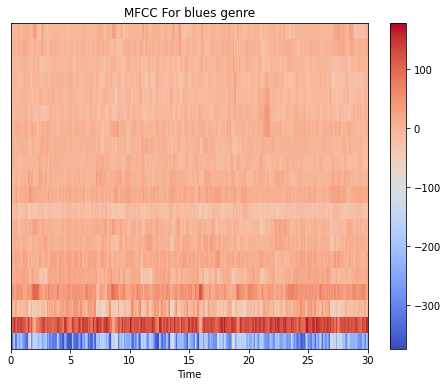

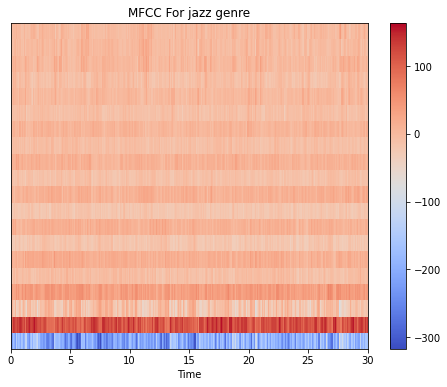

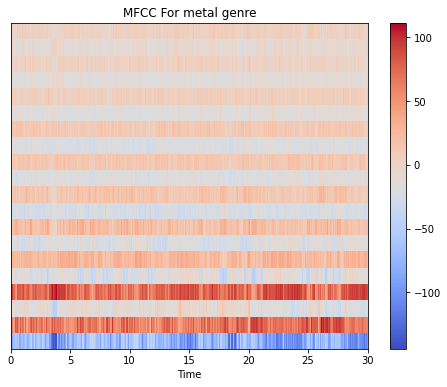

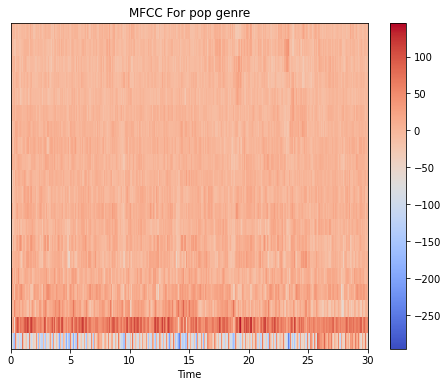

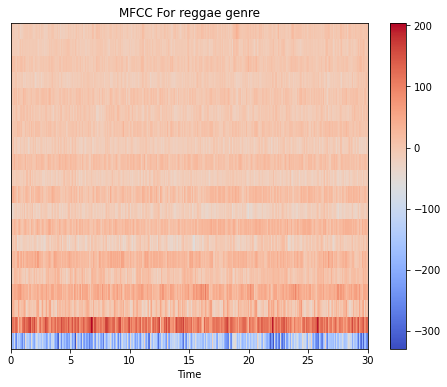

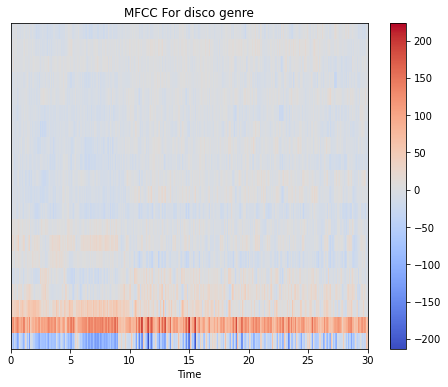

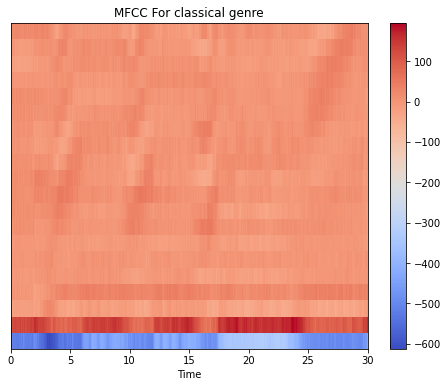

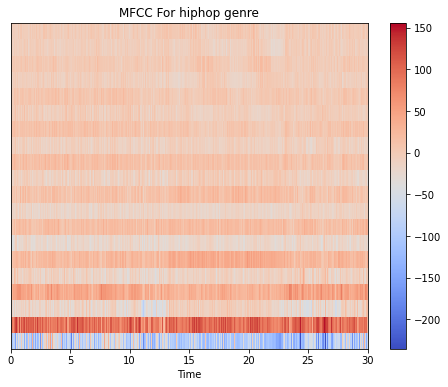

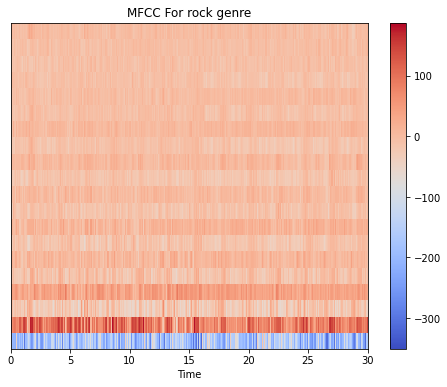

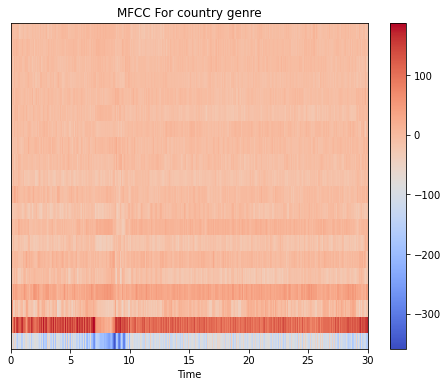

In [38]:
ax=plot_mfcc(blues,'blues');plt.show();
ax=plot_mfcc(jazz,'jazz');plt.show();
ax=plot_mfcc(metal,'metal');plt.show();
ax=plot_mfcc(pop,'pop');plt.show();
ax=plot_mfcc(reggae,'reggae');plt.show();
ax=plot_mfcc(disco,'disco');plt.show();
ax=plot_mfcc(classical,'classical');plt.show();
ax=plot_mfcc(hiphop,'hiphop');plt.show();
ax=plot_mfcc(rock,'rock');plt.show();
ax=plot_mfcc(country,'country');plt.show();

### **Zero Crossing Rate**

*   The zero-crossing rate (ZCR) is the rate at which a signal transitions from positive to zero to negative or negative to zero to positive
*  The reason behind
the importance of this particular feature is to find out at
what speed, or with how much variations the particular music
clip is following through. This could be extremely helpful in
identifying the genre of that particular clip.

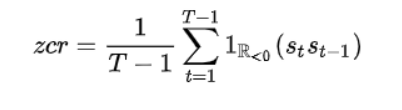

In [39]:
def plot_zero_crossing_rate(wave_file,wave_name): 
  x, fs = librosa.load(wave_file) 
  zcr_wave = librosa.feature.zero_crossing_rate(x, frame_length=1024, hop_length=512)[0]
  frames = range(len(zcr_wave))
  t = librosa.frames_to_time(frames, hop_length=512)
  fig, ax = plt.subplots(1,figsize = (8, 6))
  img=librosa.display.waveplot(x, alpha=0.5)
  plt.plot(t, zcr_wave, color="b")
  plt.ylim((-1, 1))
  # fig.colorbar(img, ax=ax)
  ax.set(title='Zero Crossing Rate For ' +wave_name+ ' genre')
  return ax

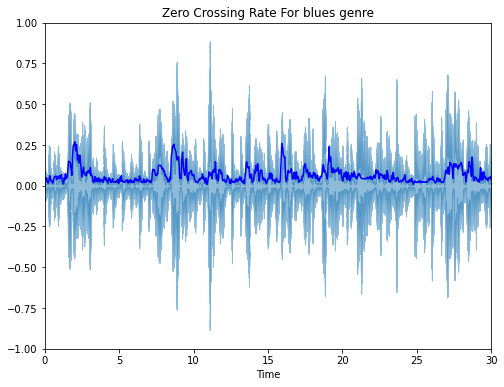

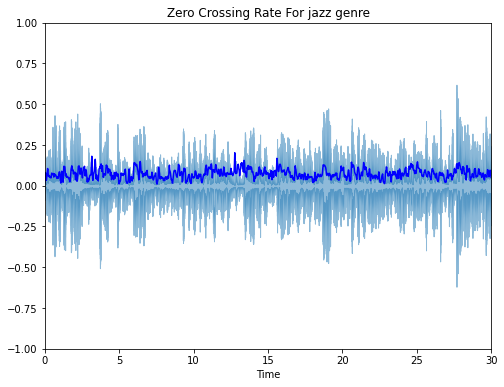

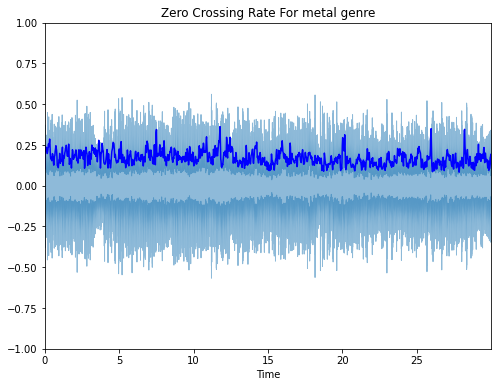

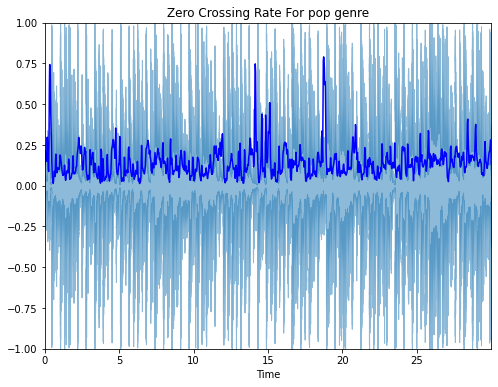

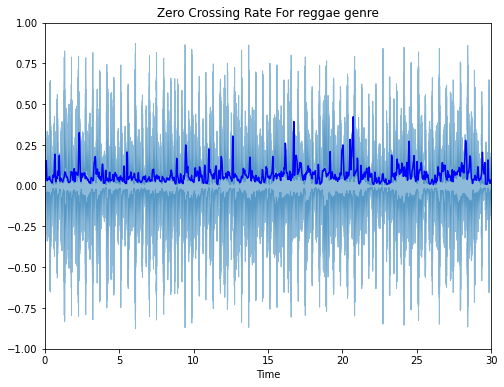

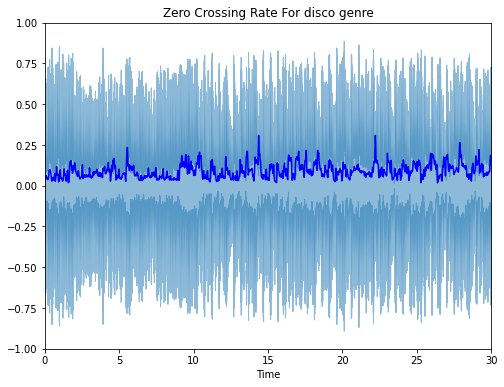

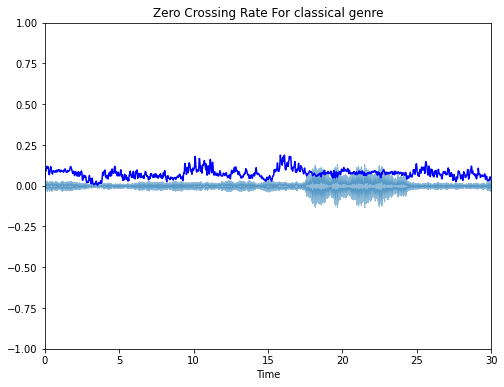

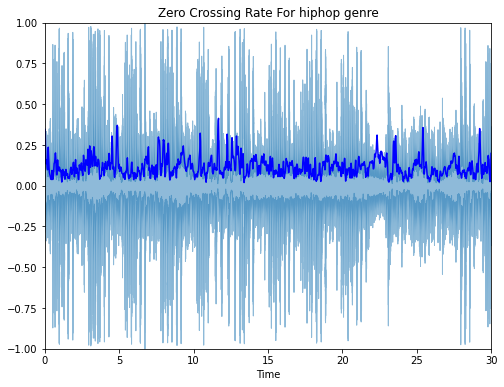

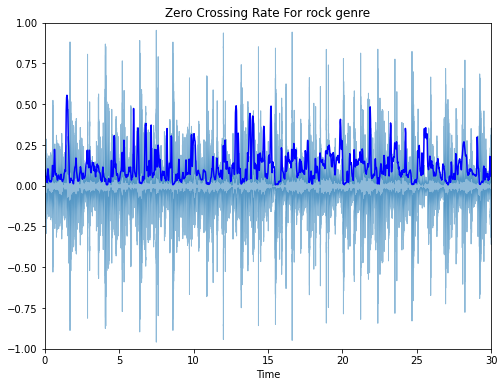

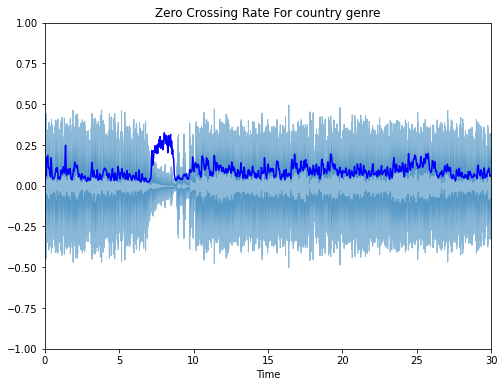

In [40]:
ax=plot_zero_crossing_rate(blues,'blues');plt.show();
ax=plot_zero_crossing_rate(jazz,'jazz');plt.show();
ax=plot_zero_crossing_rate(metal,'metal');plt.show();
ax=plot_zero_crossing_rate(pop,'pop');plt.show();
ax=plot_zero_crossing_rate(reggae,'reggae');plt.show();
ax=plot_zero_crossing_rate(disco,'disco');plt.show();
ax=plot_zero_crossing_rate(classical,'classical');plt.show();
ax=plot_zero_crossing_rate(hiphop,'hiphop');plt.show();
ax=plot_zero_crossing_rate(rock,'rock');plt.show();
ax=plot_zero_crossing_rate(country,'country');plt.show();

### **Chroma STFT**

*   Chroma Feature analysis  and synthesis
is a powerful  representation of music audio, in
which the entire spectrum is divided into 12 bins which represent 12 distinct chromas (semitones) of the musical octave
*   Without knowing the absolute frequency one can get useful information about the audio that is not apparent in the original spectra by just knowing the croma distribution.

In [41]:
def plot_chroma_stft(wave_file,wave_name):
  x, fs = librosa.load(wave_file) 
  chroma_wave=librosa.feature.chroma_stft(y=x, sr=fs)
  fig, ax = plt.subplots(1,figsize = (8, 6))
  img = librosa.display.specshow(librosa.amplitude_to_db(chroma_wave, ref=np.max),y_axis='log', x_axis='time', ax=ax)
  fig.colorbar(img,ax=ax)  
  ax.set(title='CHroma Wave For ' +wave_name+ ' genre')
  return ax


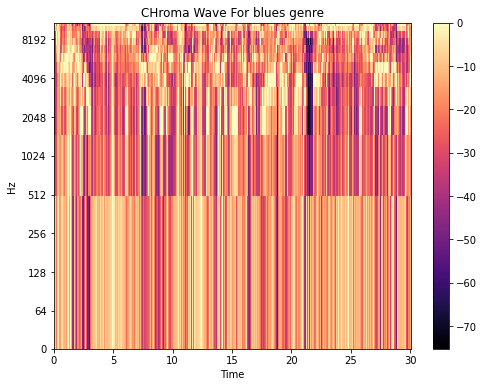

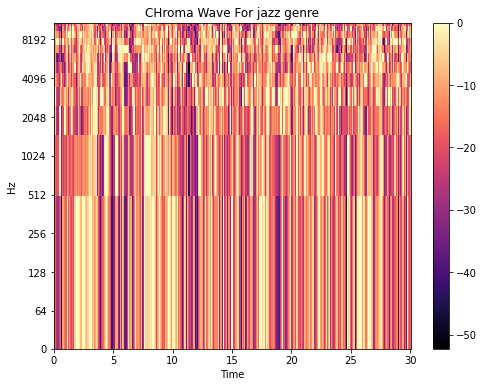

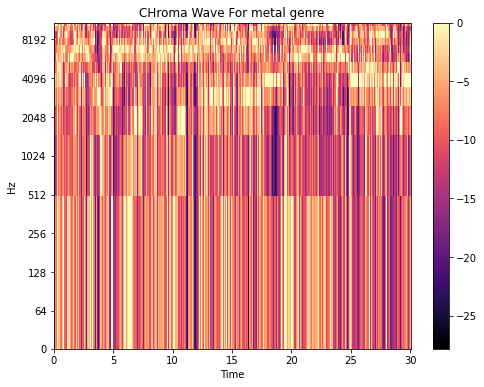

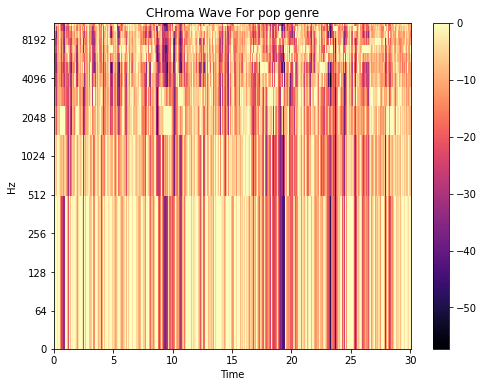

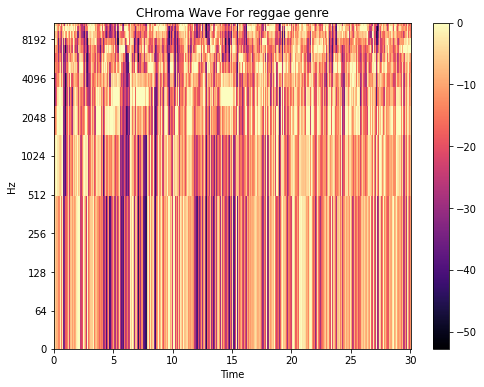

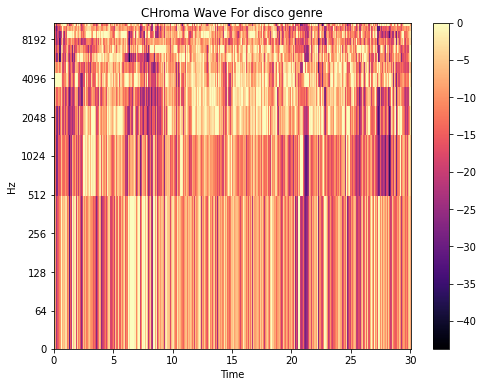

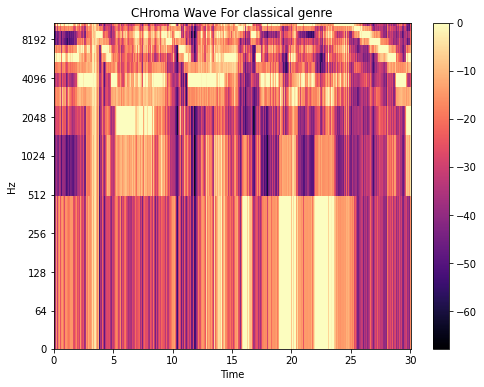

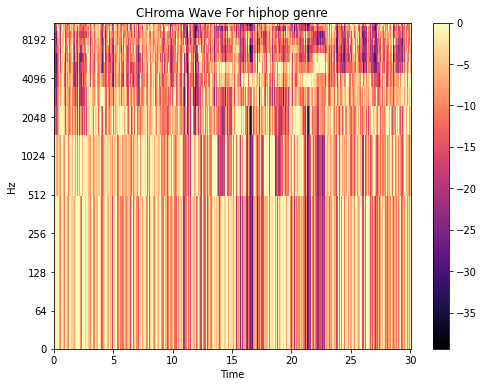

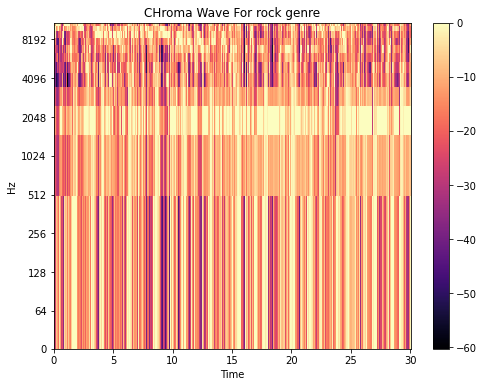

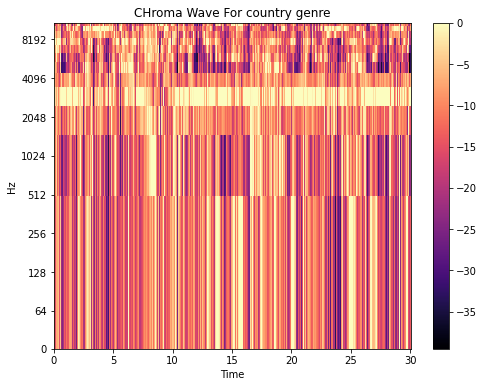

In [42]:
ax=plot_chroma_stft(blues,'blues');plt.show();
ax=plot_chroma_stft(jazz,'jazz');plt.show();
ax=plot_chroma_stft(metal,'metal');plt.show();
ax=plot_chroma_stft(pop,'pop');plt.show();
ax=plot_chroma_stft(reggae,'reggae');plt.show();
ax=plot_chroma_stft(disco,'disco');plt.show();
ax=plot_chroma_stft(classical,'classical');plt.show();
ax=plot_chroma_stft(hiphop,'hiphop');plt.show();
ax=plot_chroma_stft(rock,'rock');plt.show();
ax=plot_chroma_stft(country,'country');plt.show();

### **Beat and Tempo**

A beat in music theory is a unit of time that tracks the periodic element in music. The tempo of a song is the number of beats per minute. The tempo might change over the course of the song.Detecting beats and estimating the tempo of a song are closely related to onset detection. Usually, detecting beats and tempo of a song is done in three steps:

*   Onset detection: computing the locations of onsets based on spectral flux
*   Periodicity estimation: computing periodic patterns in the onset locations
*   Beat location estimation: computing location of beats depending on the onsets and the periodicity information

In [45]:
def plot_tempo(wave_file,wave_name):
  x, fs = librosa.load(wave_file) 
  onset_env = librosa.onset.onset_strength(x, sr=fs)
  dtempo = librosa.beat.tempo(onset_envelope=onset_env, sr=fs,aggregate=None)
  fig, ax = plt.subplots(figsize=(8,6))
  tg = librosa.feature.tempogram(onset_envelope=onset_env, sr=fs,hop_length=512)
  librosa.display.specshow(tg, x_axis='time', y_axis='tempo', cmap='magma', ax=ax)
  ax.plot(librosa.times_like(dtempo), dtempo,color='c', linewidth=1.5, label='Tempo estimate (default prior)')
  ax.set(title='Dynamic tempo estimation for '+wave_name) 
  return ax

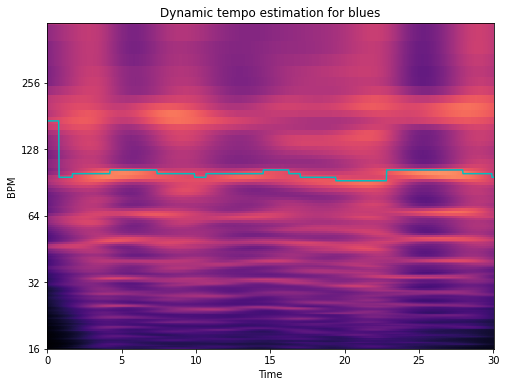

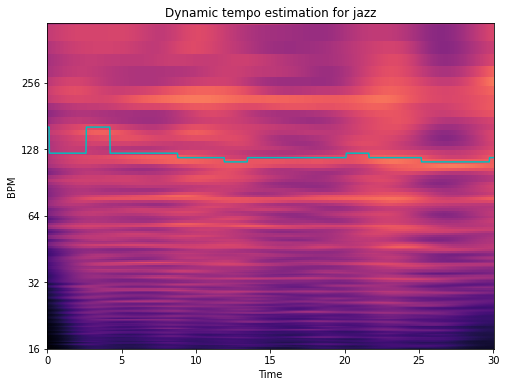

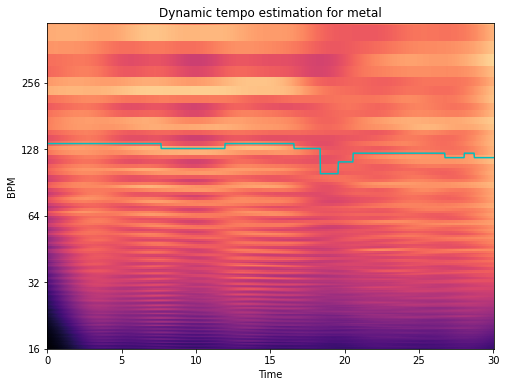

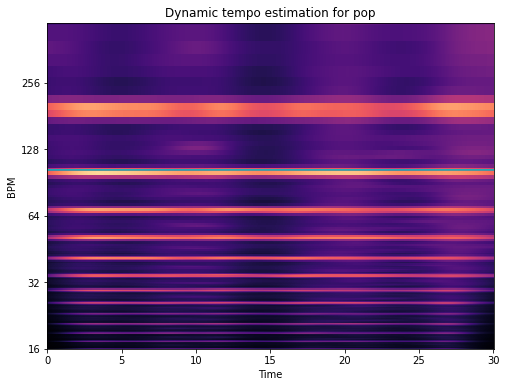

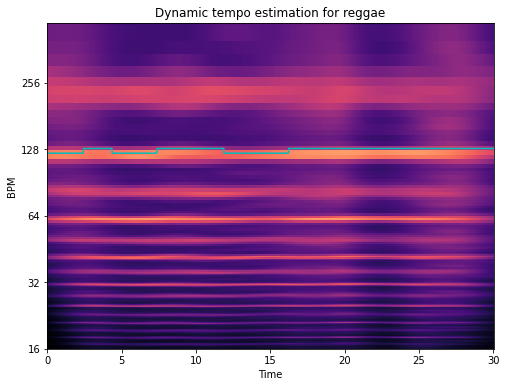

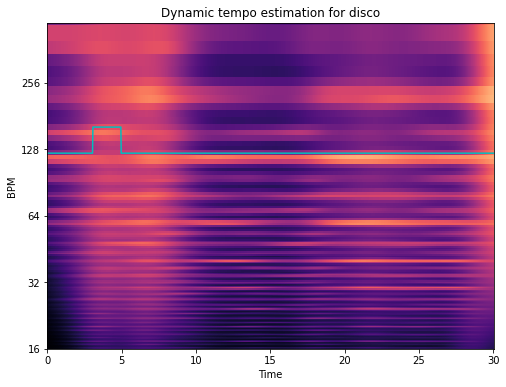

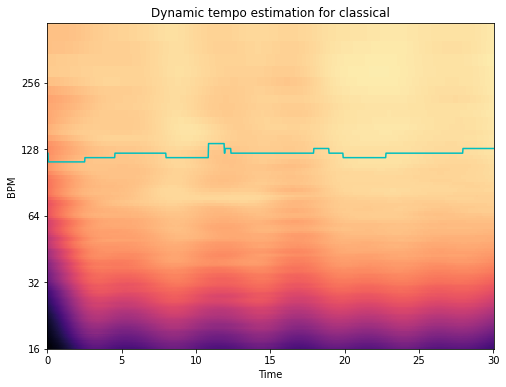

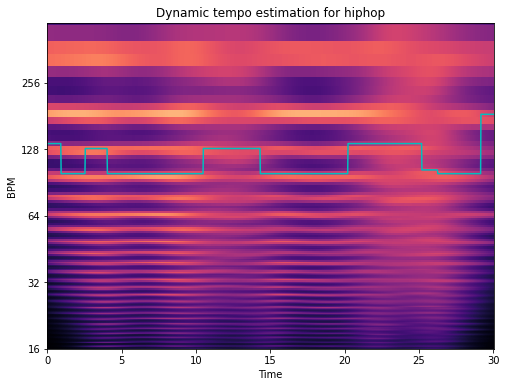

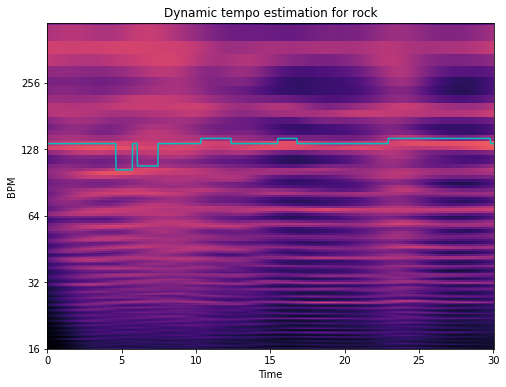

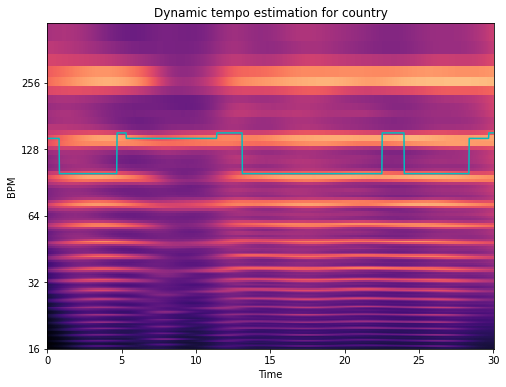

In [46]:
ax=plot_tempo(blues,'blues');plt.show();
ax=plot_tempo(jazz,'jazz');plt.show();
ax=plot_tempo(metal,'metal');plt.show();
ax=plot_tempo(pop,'pop');plt.show();
ax=plot_tempo(reggae,'reggae');plt.show();
ax=plot_tempo(disco,'disco');plt.show();
ax=plot_tempo(classical,'classical');plt.show();
ax=plot_tempo(hiphop,'hiphop');plt.show();
ax=plot_tempo(rock,'rock');plt.show();
ax=plot_tempo(country,'country');plt.show();

## **Spectral Features**

### Spectral Centroid

To start understanding how frequencies are changing in the sound signal, we can start by looking at the spectral centroids of our audio clip. These indicate where the center of mass of the spectrum is located. 

In [47]:
def plot_spectral_centroids(wave_file,wave_name):
  x, fs = librosa.load(wave_file)
  fig, ax = plt.subplots(figsize=(8,6)) 
  plt.plot(librosa.feature.spectral_centroid(x, sr=fs)[0])
  plt.xlabel('Frame number')
  plt.ylabel('frequency (Hz)')
  plt.title('Spectral centroids for '+wave_name+' genre')
  return ax

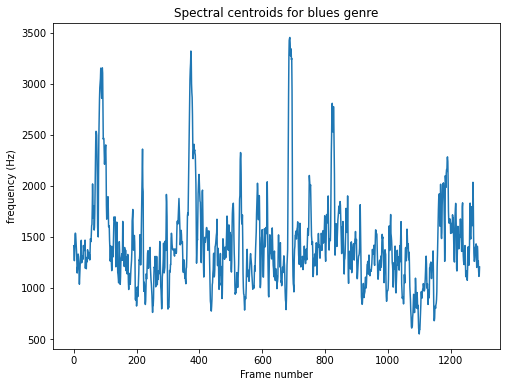

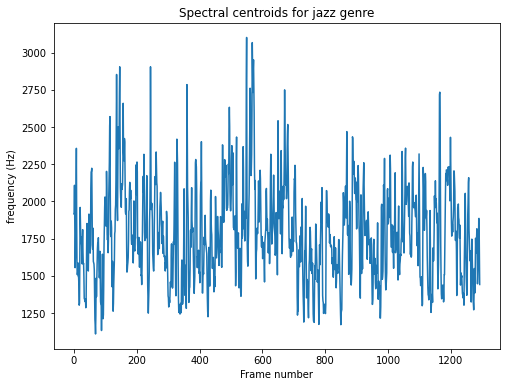

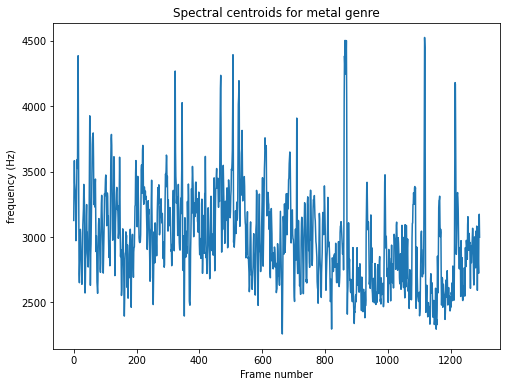

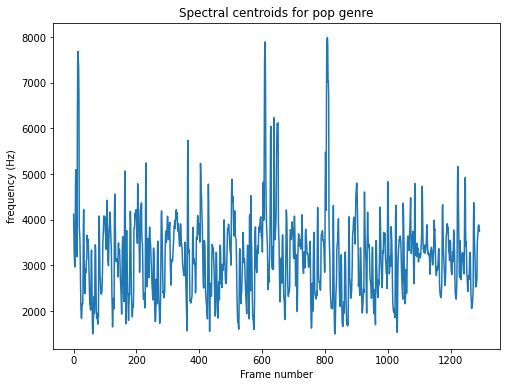

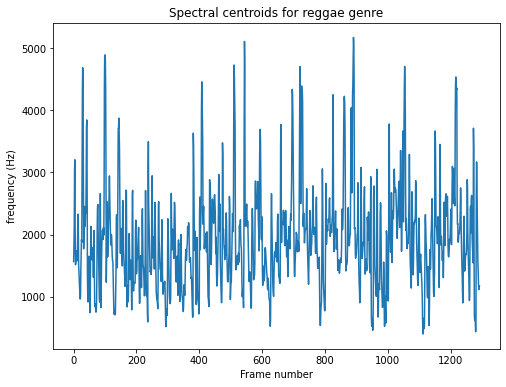

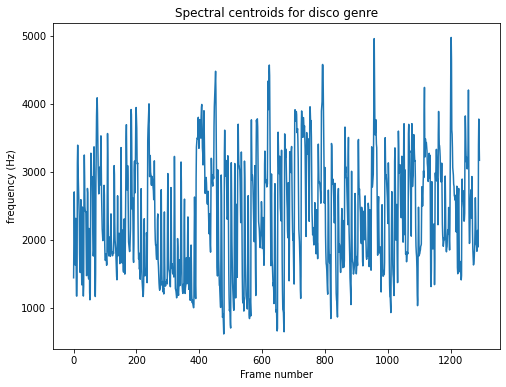

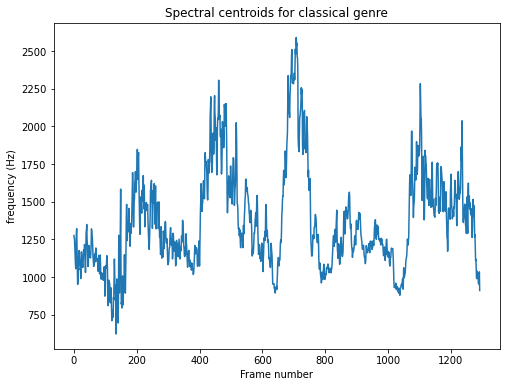

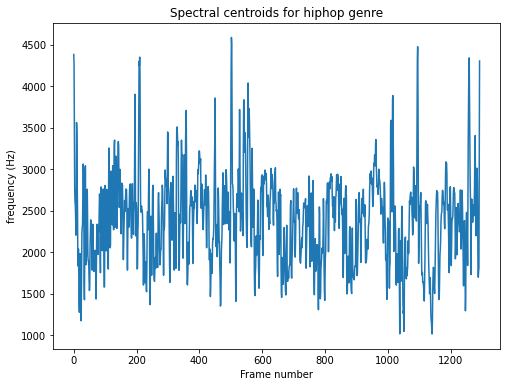

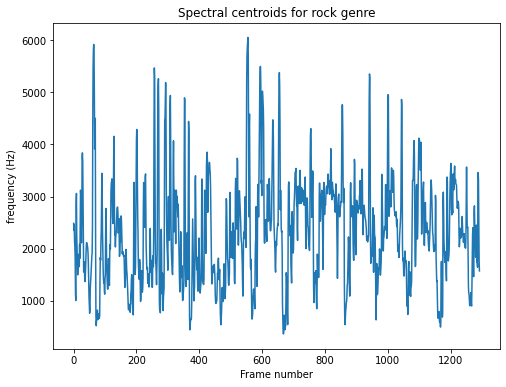

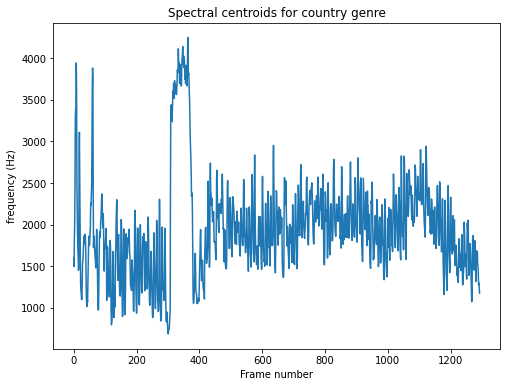

In [48]:
ax=plot_spectral_centroids(blues,'blues');plt.show();
ax=plot_spectral_centroids(jazz,'jazz');plt.show();
ax=plot_spectral_centroids(metal,'metal');plt.show();
ax=plot_spectral_centroids(pop,'pop');plt.show();
ax=plot_spectral_centroids(reggae,'reggae');plt.show();
ax=plot_spectral_centroids(disco,'disco');plt.show();
ax=plot_spectral_centroids(classical,'classical');plt.show();
ax=plot_spectral_centroids(hiphop,'hiphop');plt.show();
ax=plot_spectral_centroids(rock,'rock');plt.show();
ax=plot_spectral_centroids(country,'country');plt.show();

### Spectral Bandwidth

*   Spectral bandwidth signifies the state of the art features with which we can easily understand the state of the audio at that particular time, after which
anything relative to the audio information can be extracted
easily.

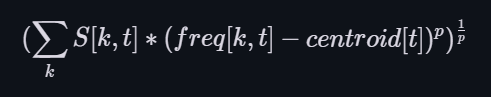

Where k is the frequency bin index, t is the time index, S [ k , t ] is the STFT magnitude at frequency bin k and time t , f r e q [ k , t ] is the frequency at frequency bin k and time t , c e n t r o i d is the spectral centroid at time t , and finally p is the power to raise deviation from spectral centroid.

In [49]:
def plot_spectral_bandwidth(wave_file,wave_name):
  x, fs = librosa.load(wave_file)
  fig, ax = plt.subplots(figsize=(8,6)) 
  plt.plot(librosa.feature.spectral_bandwidth(x, sr=fs)[0])
  plt.xlabel('Frame number')
  plt.ylabel('frequency (Hz)')
  plt.title('Spectral Bandwidth for '+wave_name+' genre')
  return ax

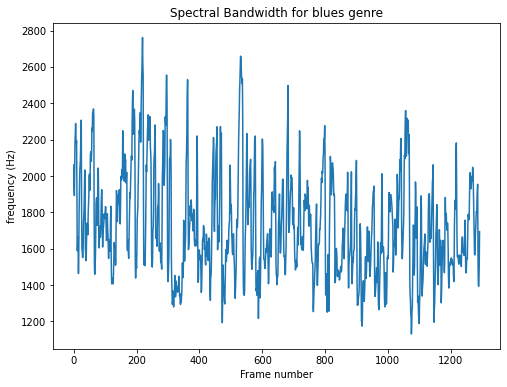

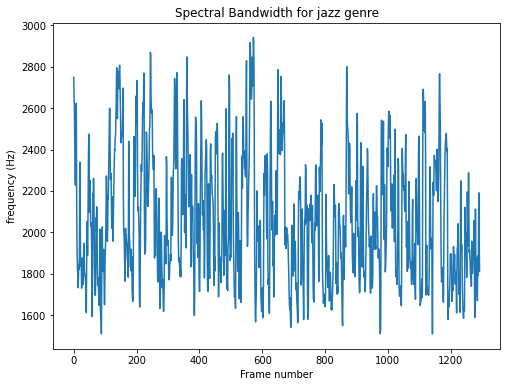

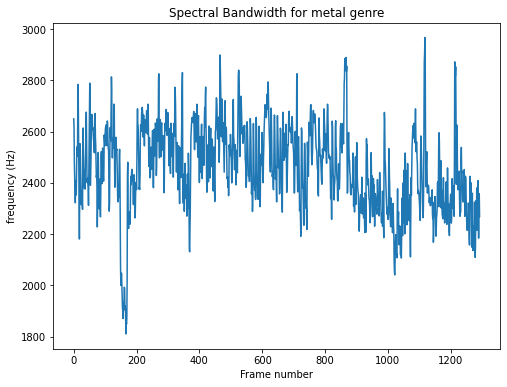

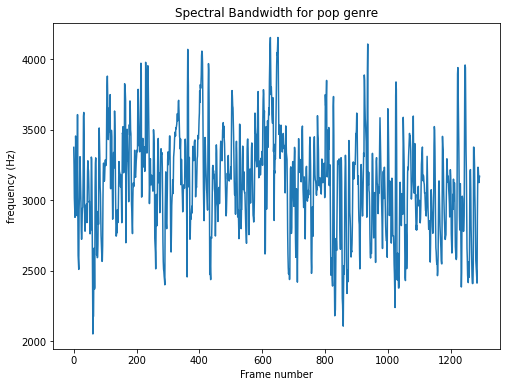

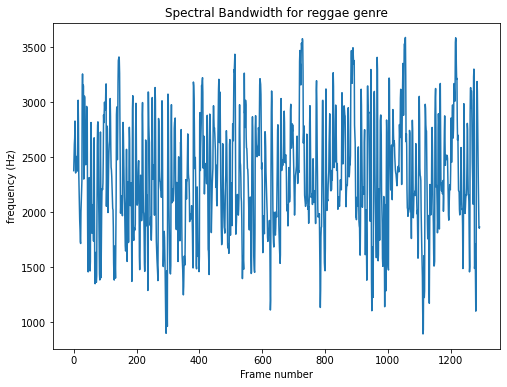

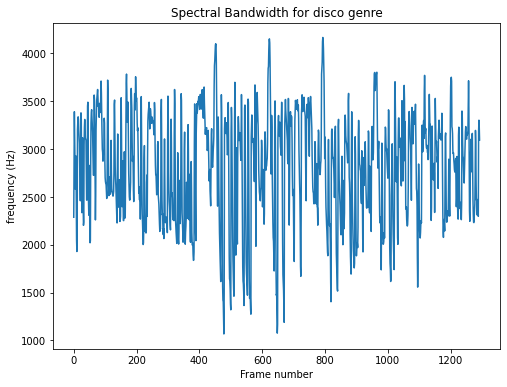

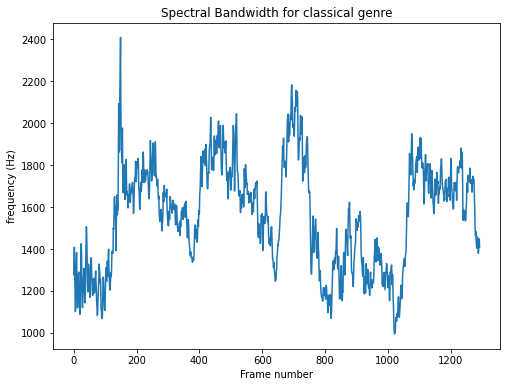

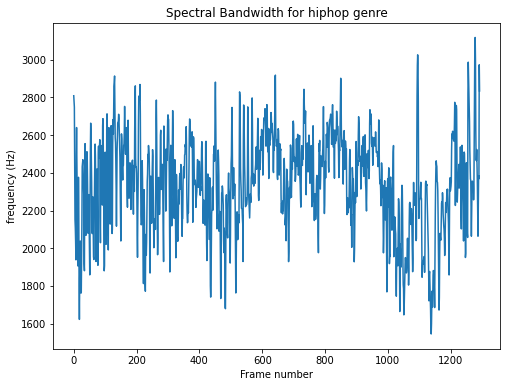

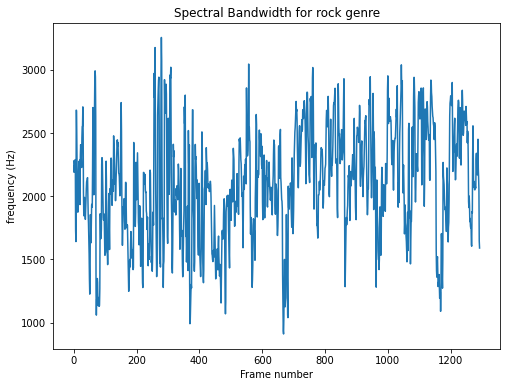

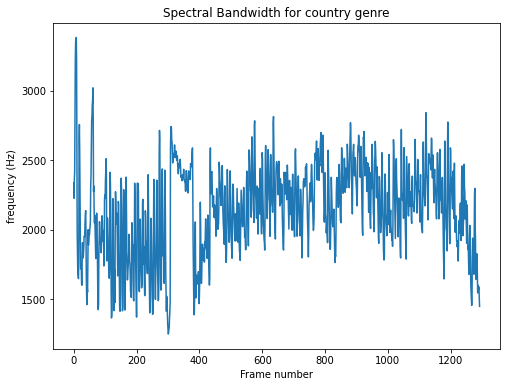

In [50]:
ax=plot_spectral_bandwidth(blues,'blues');plt.show();
ax=plot_spectral_bandwidth(jazz,'jazz');plt.show();
ax=plot_spectral_bandwidth(metal,'metal');plt.show();
ax=plot_spectral_bandwidth(pop,'pop');plt.show();
ax=plot_spectral_bandwidth(reggae,'reggae');plt.show();
ax=plot_spectral_bandwidth(disco,'disco');plt.show();
ax=plot_spectral_bandwidth(classical,'classical');plt.show();
ax=plot_spectral_bandwidth(hiphop,'hiphop');plt.show();
ax=plot_spectral_bandwidth(rock,'rock');plt.show();
ax=plot_spectral_bandwidth(country,'country');plt.show();

## Roll-off

The roll-off factor is a measure of the
excess bandwidth of the filter, i.e. the bandwidth occupied
beyond the Nyquist bandwidth. Here the roll-off is used in
order to check how much excess bandwidth is passing through

In [51]:
def plot_rolloff(wave_file,wave_name):
  x, fs = librosa.load(wave_file)
  fig, ax = plt.subplots(figsize=(8,6)) 
  plt.plot(librosa.feature.spectral_rolloff(x, sr=fs)[0])
  plt.xlabel('Frame number')
  plt.ylabel('frequency (Hz)')
  plt.title('Rolloff for '+wave_name+' genre')
  return ax

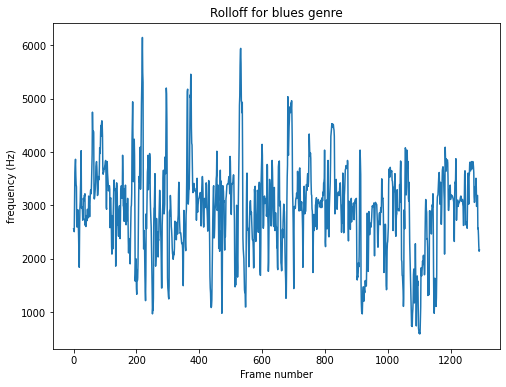

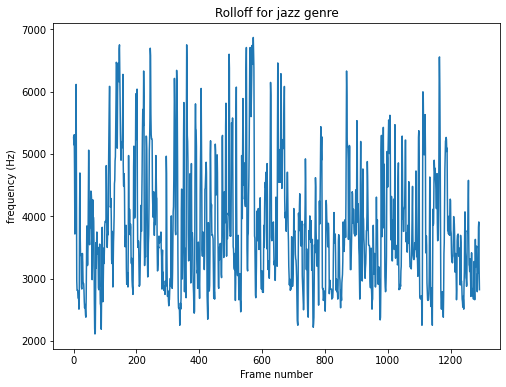

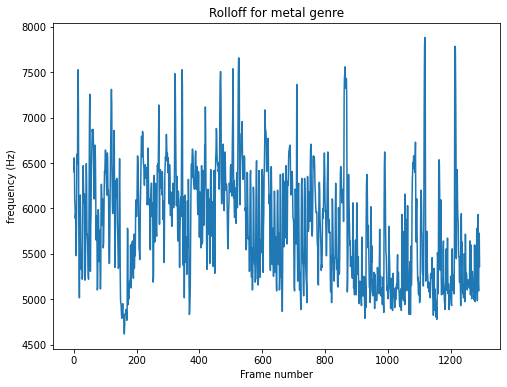

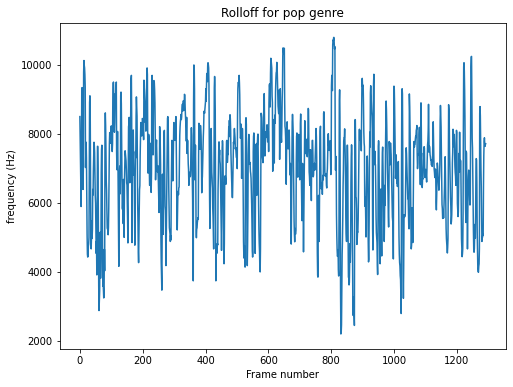

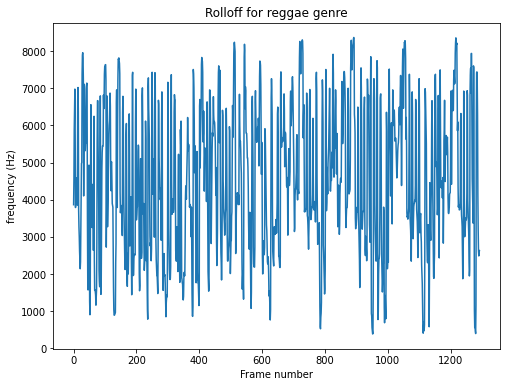

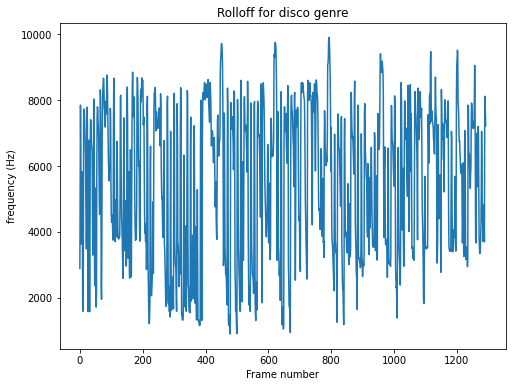

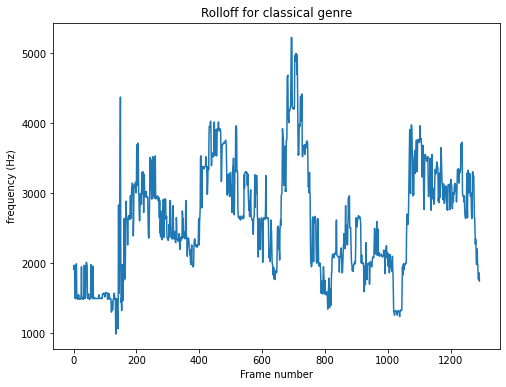

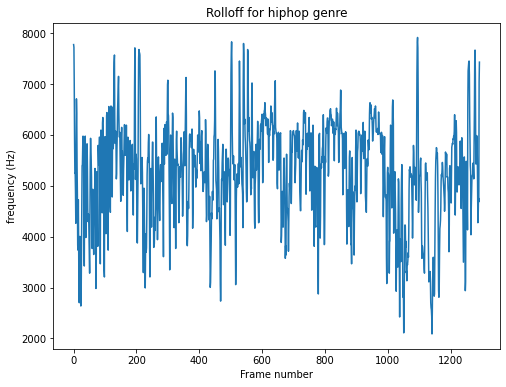

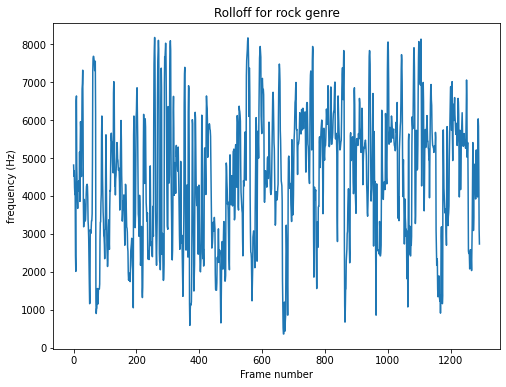

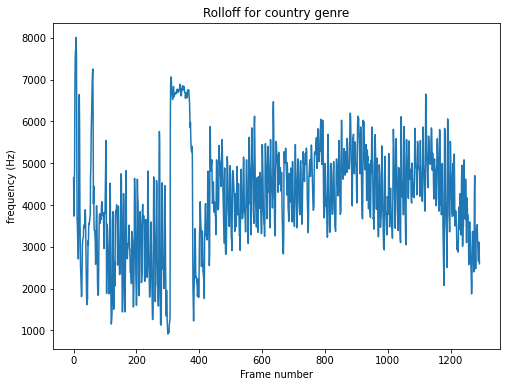

In [52]:
ax=plot_rolloff(blues,'blues');plt.show();
ax=plot_rolloff(jazz,'jazz');plt.show();
ax=plot_rolloff(metal,'metal');plt.show();
ax=plot_rolloff(pop,'pop');plt.show();
ax=plot_rolloff(reggae,'reggae');plt.show();
ax=plot_rolloff(disco,'disco');plt.show();
ax=plot_rolloff(classical,'classical');plt.show();
ax=plot_rolloff(hiphop,'hiphop');plt.show();
ax=plot_rolloff(rock,'rock');plt.show();
ax=plot_rolloff(country,'country');plt.show();

## Correlation Matrix

Correlation helps us in determining the degree of relationship between variables

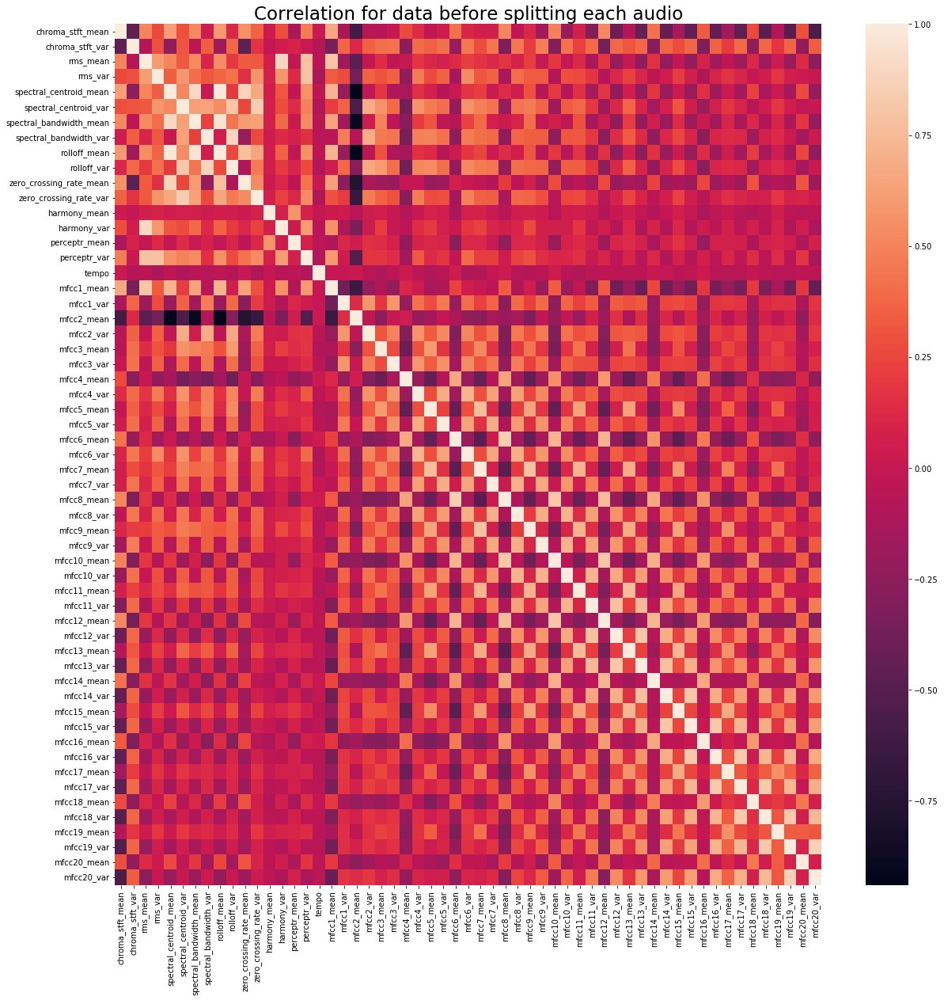

In [ ]:
corr_30_sec = data_30_sec.corr()
plt.figure(figsize=(20,20))
sns.heatmap(data=corr_30_sec)
plt.title('Correlation for data before splitting each audio', fontsize=23)
plt.show()

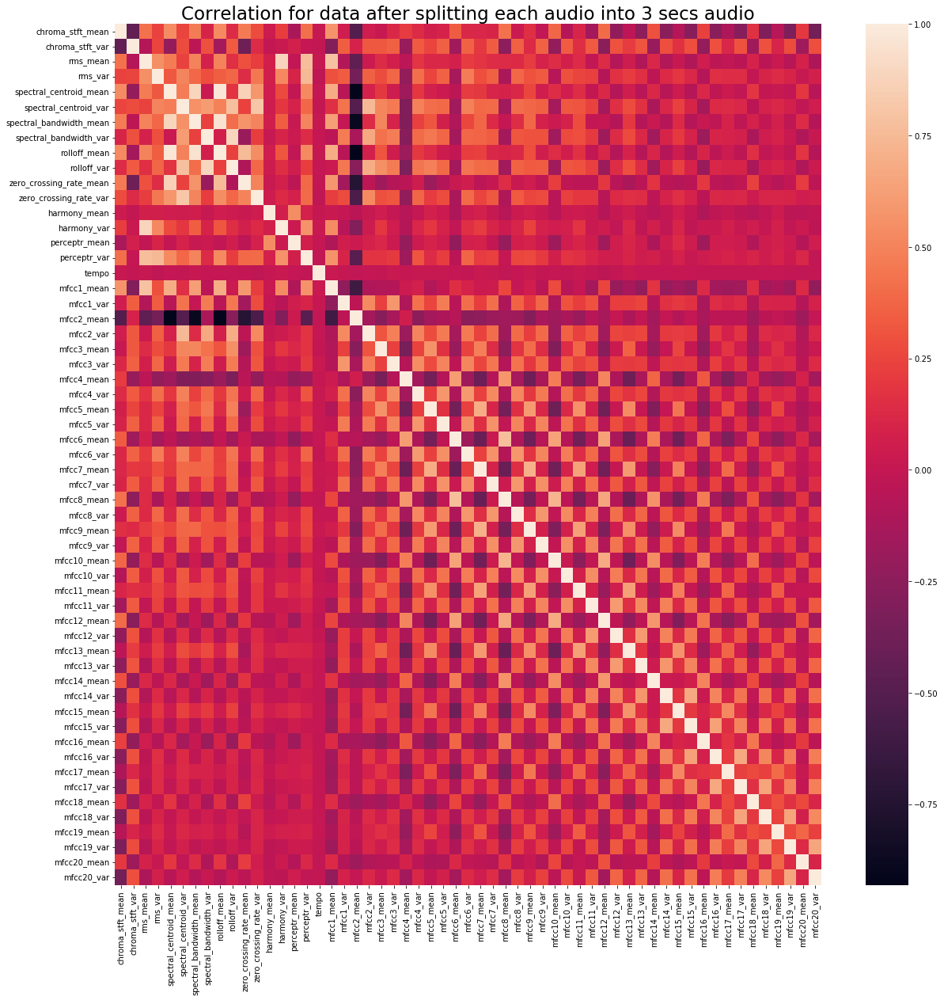

In [ ]:
corr_3_sec = data_3_sec.corr()
plt.figure(figsize=(20,20))
sns.heatmap(data=corr_3_sec)
plt.title('Correlation for data after splitting each audio into 3 secs audio', fontsize=23)
plt.show()

## Distribution of All features across genres

A violin plot is a hybrid of a box plot and a kernel density plot, which shows peaks in the data. It is used to visualize the distribution of numerical data.

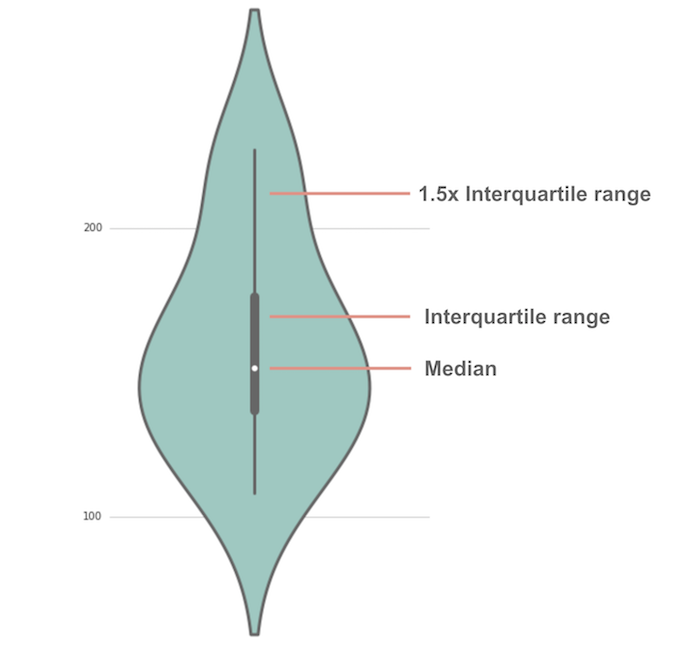

*   On each side of the gray line is a kernel density estimation to show the distribution shape of the data. Wider sections of the violin plot represent a higher probability that members of the population will take on the given value; the skinnier sections represent a lower probability.

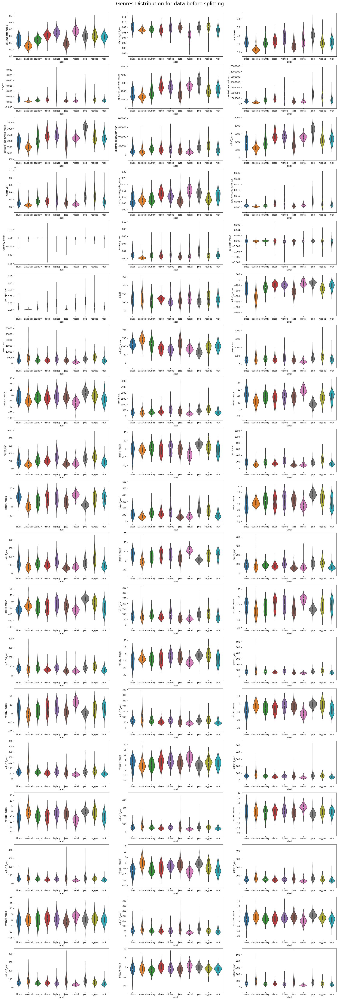

In [ ]:
col = data_30_sec.columns
fig, axs = plt.subplots(19,3, figsize=(27,75))

iter = 0
for j in range(19):
    for i in range(3):
        sns.violinplot(data=data_30_sec, x='label', y=col[iter], ax=axs[j][i])
        iter += 1
fig.suptitle('Genres Distribution for data before splitting', fontsize=23)
fig.subplots_adjust(top=0.97)
plt.show()

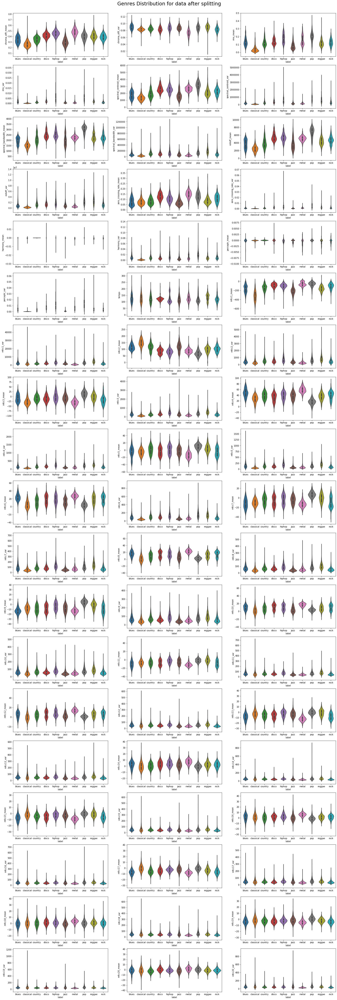

In [ ]:
col = data_3_sec.columns
fig, axs = plt.subplots(19,3, figsize=(27,75))

iter = 0
for j in range(19):
    for i in range(3):
        sns.violinplot(data=data_3_sec, x='label', y=col[iter], ax=axs[j][i])
        iter += 1
fig.suptitle('Genres Distribution for data after splitting', fontsize=23)
fig.subplots_adjust(top=0.97)
plt.show()

# Testing Different Models

In [ ]:
from sklearn.utils import shuffle
data_3_sec = shuffle(data_3_sec)

In [ ]:
X = data_3_sec.drop('label', axis=1)
y = data_3_sec['label']

In [ ]:
from sklearn.model_selection import cross_val_score, train_test_split, StratifiedKFold
from sklearn.metrics import accuracy_score, auc, roc_auc_score, roc_curve, confusion_matrix, f1_score, accuracy_score, precision_score, recall_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, BaggingClassifier, ExtraTreesClassifier
from lightgbm import LGBMClassifier

simple_models = [DecisionTreeClassifier(), RandomForestClassifier(), GradientBoostingClassifier(), ExtraTreesClassifier(), BaggingClassifier(), LGBMClassifier()]

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X, y, random_state=0)
cls_wse_acc = {}
scores = []
f1_scores = []
precision = []
recall = []
model_name = []
for model in simple_models:
    model_name.append(str(model)[0:-2])

    batch_scores = []
    batch_f1_scores = []
    batch_precision = []
    batch_recall = []

    cls_wise = []
    conf_mat = np.zeros((10,10))
    for train_indx, val_indx in StratifiedKFold(n_splits=3, shuffle=True, random_state=0).split(X, y):
        X1, y1 = np.array(X)[train_indx], np.array(y)[train_indx]
        X2, y2 = np.array(X)[val_indx], np.array(y)[val_indx]

        model.fit(X1, y1)
        y_pred = model.predict(X2)
        batch_scores.append(accuracy_score(y2, y_pred))
        batch_f1_scores.append(f1_score(y2, y_pred, average='weighted'))
        batch_precision.append(precision_score(y2, y_pred, average='weighted'))
        batch_recall.append(recall_score(y2, y_pred, average='weighted'))
        conf_mat += confusion_matrix(y2, y_pred, labels=np.unique(y1))
    
    conf_mat /= 3

    for i in range(10):        #Calculating Classwise Accuracy
        cls_wise.append(np.sum(conf_mat[i,i])/np.sum(conf_mat[:,i]))

    cls_wse_acc[str(model)[0:-2]] = cls_wise        

    scores.append(np.mean(batch_scores))
    f1_scores.append(np.mean(batch_f1_scores))
    precision.append(np.mean(batch_precision))
    recall.append(np.mean(batch_recall))

In [ ]:
model_report_df = pd.DataFrame([model_name, scores, f1_scores, precision, recall]).T
model_report_df.columns = ['Model','Accuracy','f1_score','Precision','Recall']
model_report_df

,Model,Accuracy,f1_score,Precision,Recall
0,DecisionTreeClassifier,0.636937,0.636973,0.637702,0.636937
1,RandomForestClassifier,0.857758,0.856972,0.858427,0.857758
2,GradientBoostingClassifier,0.818919,0.818879,0.819912,0.818919
3,ExtraTreesClassifier,0.879279,0.878565,0.879984,0.879279
4,BaggingClassifier,0.773373,0.77184,0.775097,0.773373
5,LGBMClassifier,0.898198,0.898267,0.898993,0.898198


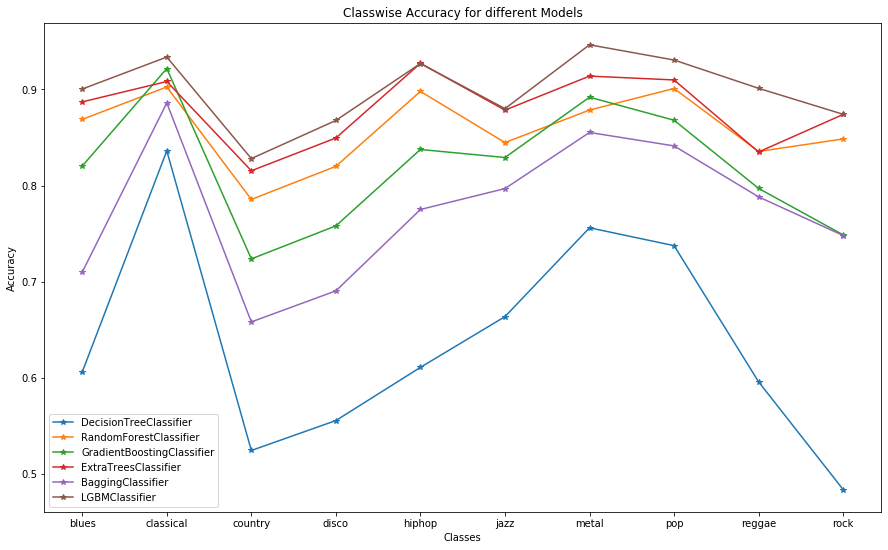

In [ ]:
plt.figure(figsize=(15,9))
for i in cls_wse_acc.keys():
    plt.plot(cls_wse_acc[i], label=i, marker='*')
    
plt.xticks(range(10),np.unique(y1))
plt.legend()
plt.title('Classwise Accuracy for different Models')
plt.ylabel('Accuracy')
plt.xlabel('Classes')
plt.show()

# Hyperparameter Tunning

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
param_grid = {'learning_rate':[0.1,0.15,0.05], 'num_iterations':[500,1000], 'max_depth':[20,30], 'max_bin':[30,40,50], 'num_leaves':[40,50,60]}

lgbm_cls = LGBMClassifier(random_state=0)

rand_grid_search = RandomizedSearchCV(lgbm_cls, param_grid, scoring='accuracy', cv=3, return_train_score=True, n_iter=20, random_state=0)
rand_grid_search.fit(X, y)
rand_grid_search.best_params_

/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWar

{'num_leaves': 40,
 'num_iterations': 1000,
 'max_depth': 20,
 'max_bin': 30,
 'learning_rate': 0.05}

### Model with best parameters

In [ ]:
lgbm_cls = LGBMClassifier(learning_rate=0.05, num_iterations = 1000, random_state=0, max_depth=20, num_leaves=40, max_bin=30)

scores = cross_val_score(lgbm_cls, X, y, cv=4, scoring='accuracy')
print('CV Scores', scores, ' -> ', scores.mean())

/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


CV Scores [0.92473979 0.9307446  0.92190629 0.91509812]  ->  0.9231221981990879


/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/r0ckner/.local/lib/python3.8/site-packages/lightgbm/engine.py:177: UserWar

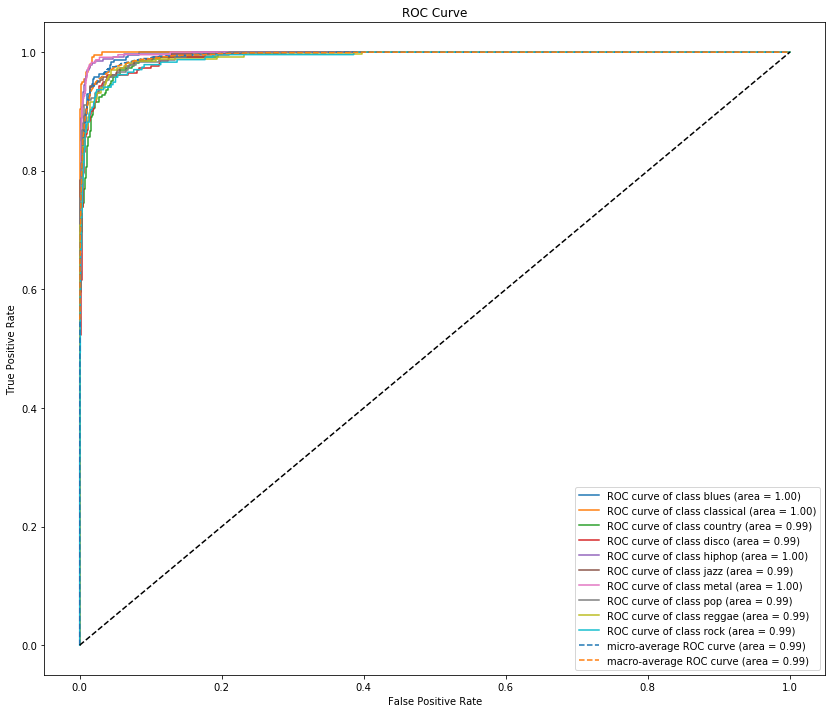

In [ ]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelBinarizer

binarizer = LabelBinarizer()
y_bin = binarizer.fit_transform(y=y)

X_train, X_val, y_btrain, y_bval = train_test_split(X, y_bin, random_state=0)

ovr = OneVsRestClassifier(lgbm_cls)
ovr.fit(X_train, y_btrain)

y_score = ovr.predict_proba(X_val)

fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(10):
    fpr[i], tpr[i], _ = roc_curve(y_bval[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_bval.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(10)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(10):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])


# Finally average it and compute AUC
mean_tpr /= 10  

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

plt.figure(figsize=(14,12))

for i in range(10):
    plt.plot(fpr[i],tpr[i],label="ROC curve of class {0} (area = {1:0.2f})".format(binarizer.classes_[i], roc_auc[i]))

plt.plot(fpr["micro"],tpr["micro"],label="micro-average ROC curve (area = {0:0.2f})".format(roc_auc["micro"]),linestyle="--",)

plt.plot(fpr["macro"],tpr["macro"],label="macro-average ROC curve (area = {0:0.2f})".format(roc_auc["macro"]),linestyle="--",)

plt.plot([0, 1], [0, 1], "k--")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend(loc="lower right")
plt.show()